Plots.PlotlyBackend()

In [1]:
using DifferentialEquations
using Plots
using TransferEntropy

In [28]:
function hurtzian(du,u,p,t)
    du[1] = -5.0*u[1]+u[2]
    du[2] = -1.0*u[2]
    du[3] = -2.0*u[3]+u[2]
  end
  
  function σ_hurtzian(du,u,p,t)
    du[1] = 1.0
    du[2] = 1.0
    du[3] = 1.0
  end
  
prob_sde_hurtzian = SDEProblem(hurtzian,σ_hurtzian,[0.0,0.0,0.0],(0.0,100000.0))
sol = solve(prob_sde_hurtzian, EM(), dt=0.001, saveat=1.0)
1

1

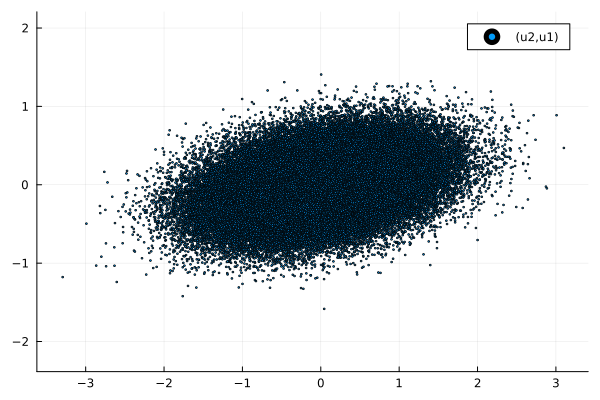

In [29]:
plot(sol,vars=(2,1),seriestype = :scatter, markersize = 1.0, aspect_ratio = 1)

In [30]:
est = Kraskov(k = 4)
for s in [1,2,3]
    for d in [1,2,3]
        if s == d
            continue
        end
        (s+d == 3) ? c = 3 : ((s+d == 4) ? c = 2 : c = 1)
        source = [sol.u[i][s] for i in 1:length(sol.u)]
        dest = [sol.u[i][d] for i in 1:length(sol.u)]
        cond = [sol.u[i][c] for i in 1:length(sol.u)]
        print("Transfer from ", s, " to ", d, " cond ", c,": ")
        println(transferentropy(source, dest, cond, est))
    end
end

Transfer from 1 to 2 cond 3: 0.01693803208823219
Transfer from 1 to 3 cond 2: 0.012931236664638135
Transfer from 2 to 1 cond 3: 0.03218758726394633
Transfer from 2 to 3 cond 1: 0.054553323231770534
Transfer from 3 to 1 cond 2: 0.007367926497611421
Transfer from 3 to 2 cond 1: 0.011337950353903281
